# 读取结果画图

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from swmm_api import read_inp_file, read_out_file,read_rpt_file
from pyswmm import Simulation
import get_output
import flooding_fig

In [2]:
def simulation(filename):
    with Simulation(filename) as sim:
       #stand_reward=0
        for step in sim:
            pass    

In [3]:
items=['HC','BC_test_result','EFD_test_result',
       'ddqn nosafe_test_result','ddqn safe_test_result',
       'ppo2 nosafe_test_result','ppo2 safe_test_result']
rains=[str(i) for i in range(10)]

# 先运行所有inp生成out文件

In [7]:
#40和80分别运行

#40，选3,5,6,7,9
pack='final-noAFI-drain-40'
for item in items:
    for rain in [str(i) for i in range(10)]:#['3','5','6','7','9']:
        file='./'+pack+'/'+item+'/'+rain
        simulation(file+'.inp')

#80，选1,4,5,7,9
pack='final-noAFI-drain-80'
for item in items:
    for rain in [str(i) for i in range(10)]:#['1','4','5','7','9']:
        file='./'+pack+'/'+item+'/'+rain
        simulation(file+'.inp')

# 读取Flooding结果数据

In [ ]:
#从所有inp文件逐步运行，获取其中flooding，有保存数据的话不要运行这个
for pack in ['final-noAFI-drain-40','final-noAFI-drain-80']:
    data={}
    for rain in rains:
        tem=[]
        for item in items:
            file='./'+pack+'/'+item+'/'+rain
            tem.append(flooding_fig.Get_flooding(file))   # type: swmm_api.SwmmOut
        data[rain]=tem
    if pack=='final-noAFI-drain-80':
        writer = pd.ExcelWriter('Flooding results_80.xlsx')
    else:
        writer = pd.ExcelWriter('Flooding results_40.xlsx')
    for rain in [str(i) for i in range(10)]:
        tem=[]
        for item in range(len(items)):
            tem.append(data[rain][item])
        df=pd.DataFrame(np.array(tem))
        df.to_excel(writer,sheet_name='rain'+rain)
    writer.save()

In [4]:
#读取flooding excel数据
#挑选大于40与大于80的各5个不重复有代表性的结果
data={}
rainid=0
#40，选3，5，6，7，9
for rain in [3,5,6,7,9]:
    #data[rain]=pd.read_excel('Flooding results_short.xlsx',sheet_name='rain'+rain).values[:,1:]
    data[str(rainid)]=pd.read_excel('Flooding results_40.xlsx',sheet_name='rain'+str(rain)).values[:,1:]
    rainid+=1

#80，选1,4,5,7,9
for rain in [1,4,5,7,9]:
    #data[rain]=pd.read_excel('Flooding results_short.xlsx',sheet_name='rain'+rain).values[:,1:]
    data[str(rainid)]=pd.read_excel('Flooding results_80.xlsx',sheet_name='rain'+str(rain)).values[:,1:]
    rainid+=1

In [5]:
#保存flooding值为excel表，方便复制 
items=['HC','BC_test_result','EFD_test_result',
       'ddqn nosafe_test_result','ddqn safe_test_result',
       'ppo2 nosafe_test_result','ppo2 safe_test_result']
rains=[str(i) for i in range(10)]
save=[]
for rain in rains:
    tem=[]
    for k in range(len(items)):
        tem.append(data[rain][k][-1])
    save.append(tem)

pd.DataFrame(save).to_excel('all_flooding.xlsx')
        

143


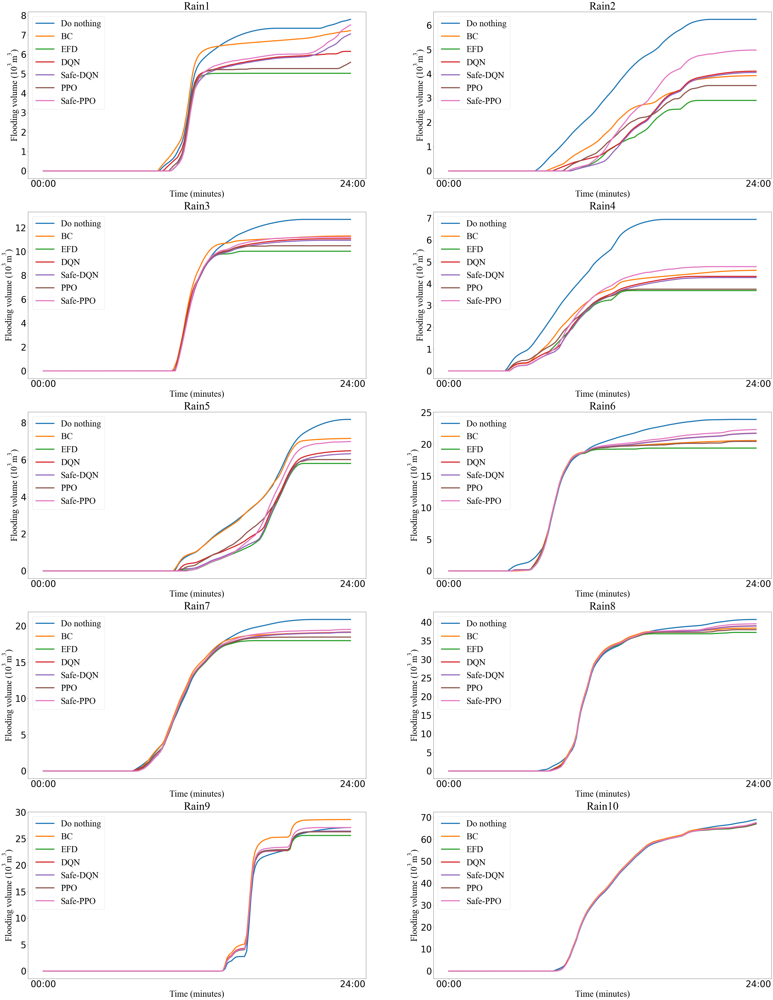

In [6]:
titles=['Do nothing','BC','EFD','DQN','Safe-DQN','PPO','Safe-PPO']
fig=plt.figure(figsize=(60,80))

simt=data['0'].shape[1]
print(simt)

font1 = {'family' : 'Times New Roman',
'weight' : 'normal',
'size' : 40,
}
font0 = {'family' : 'Times New Roman',
'weight' : 'normal',
'size' : 50,
}
myt=['00:00','24:00']
myx=[0,simt]
img=1
for i in range(1,6):
    for j in range(1,3):
        fig.add_subplot(5,2,img)
        k=0
        for i in range(len(items)):
            plt.title('Rain'+str(img),fontdict=font0)
            plt.plot(data[str(img-1)][k],linewidth=5,label=titles[k])
            plt.xticks(myx,myt,fontsize=40)
            plt.yticks(fontsize=40)
            plt.xlabel('Time (minutes)',font1)
            plt.ylabel('Flooding volume ($\mathregular{10^3}\mathregular{m^3}$)',font1)
            k=k+1
        img+=1
        plt.legend(prop=font1)
fig.savefig('5.1.1.png',bbox_inches='tight',dpi=100)

# 读取T1-6水位数据

In [8]:
#从rpt获取平均水位
#40和80分别取

data_d_average={}
rainid=0
#40，选3,5,6,7,9
pack='final-noAFI-drain-40'
for rain in [3,5,6,7,9]:
    tem=[]
    for item in items:
        file='./'+pack+'/'+item+'/'+str(rain)+'.rpt'
        rpt = read_rpt_file(file)  # type: swmm_api.SwmmReport
        node_d = rpt.node_depth_summary  # type: pandas.DataFrame
        tem.append(node_d)
    data_d_average[str(rainid)]=tem
    rainid+=1
    
#80，选1,4,5,7,9
pack='final-noAFI-drain-80'
for rain in [1,4,5,7,9]:
    tem=[]
    for item in items:
        file='./'+pack+'/'+item+'/'+str(rain)+'.rpt'
        rpt = read_rpt_file(file)  # type: swmm_api.SwmmReport
        node_d = rpt.node_depth_summary  # type: pandas.DataFrame
        tem.append(node_d)
    data_d_average[str(rainid)]=tem
    rainid+=1

In [9]:
#获取平均水位，并将其保存到excel，方便复制
data=[]
for rain in [str(i) for i in range(10)]:
    print('Rain number:',rain)
    tem=[]
    for item in range(len(items)):
        average=0
        for pool in ['T1','T2','T3','T4','T5','T6']:
            average+=data_d_average[rain][item]['Average_Depth_Meters'][pool]
        print(items[item],':',average/6)
        tem.append(average/6)
    data.append(tem)
df=pd.DataFrame(data)
df.to_excel('average_waterlevel.xlsx')

Rain number: 0
HC : 1.83
BC_test_result : 2.855
EFD_test_result : 2.6766666666666663
ddqn nosafe_test_result : 2.6316666666666664
ddqn safe_test_result : 2.5566666666666666
ppo2 nosafe_test_result : 2.74
ppo2 safe_test_result : 2.6333333333333333
Rain number: 1
HC : 2.1483333333333334
BC_test_result : 3.4899999999999998
EFD_test_result : 3.4
ddqn nosafe_test_result : 3.3466666666666662
ddqn safe_test_result : 3.313333333333334
ppo2 nosafe_test_result : 3.3983333333333334
ppo2 safe_test_result : 3.3000000000000003
Rain number: 2
HC : 1.8616666666666666
BC_test_result : 2.7033333333333336
EFD_test_result : 2.5566666666666666
ddqn nosafe_test_result : 2.4883333333333333
ddqn safe_test_result : 2.473333333333333
ppo2 nosafe_test_result : 2.5799999999999996
ppo2 safe_test_result : 2.501666666666667
Rain number: 3
HC : 2.23
BC_test_result : 3.606666666666667
EFD_test_result : 3.518333333333333
ddqn nosafe_test_result : 3.5033333333333334
ddqn safe_test_result : 3.4466666666666668
ppo2 nosafe

# 读取V1-V6流量数据

1429
1429
1429
1429
1429
1429
1429
1429
1429
1429
1429
1429


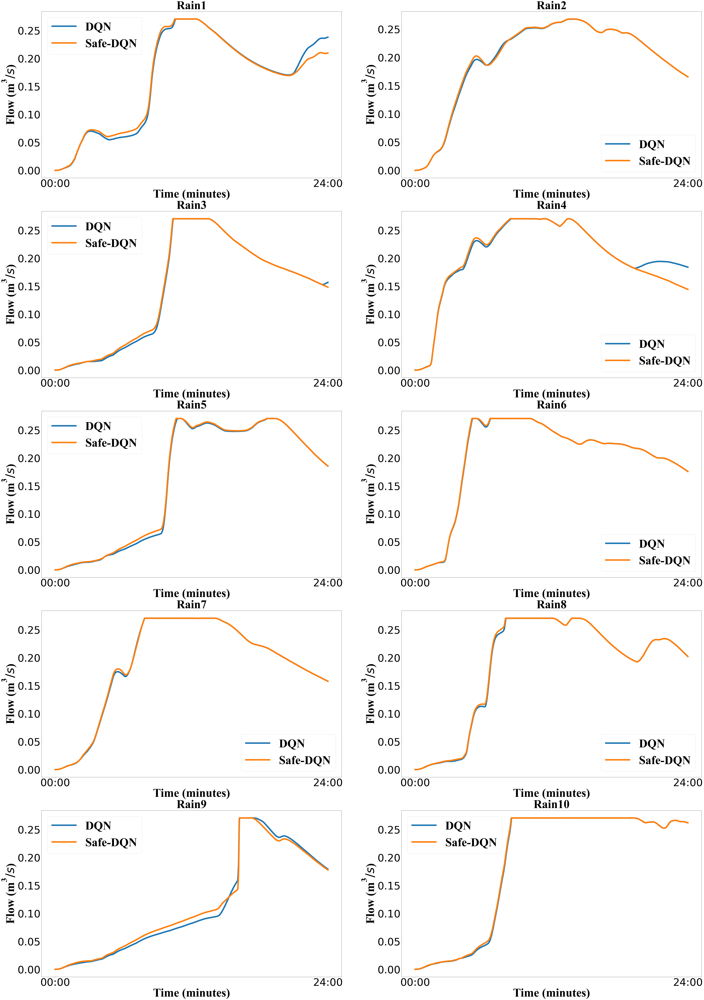

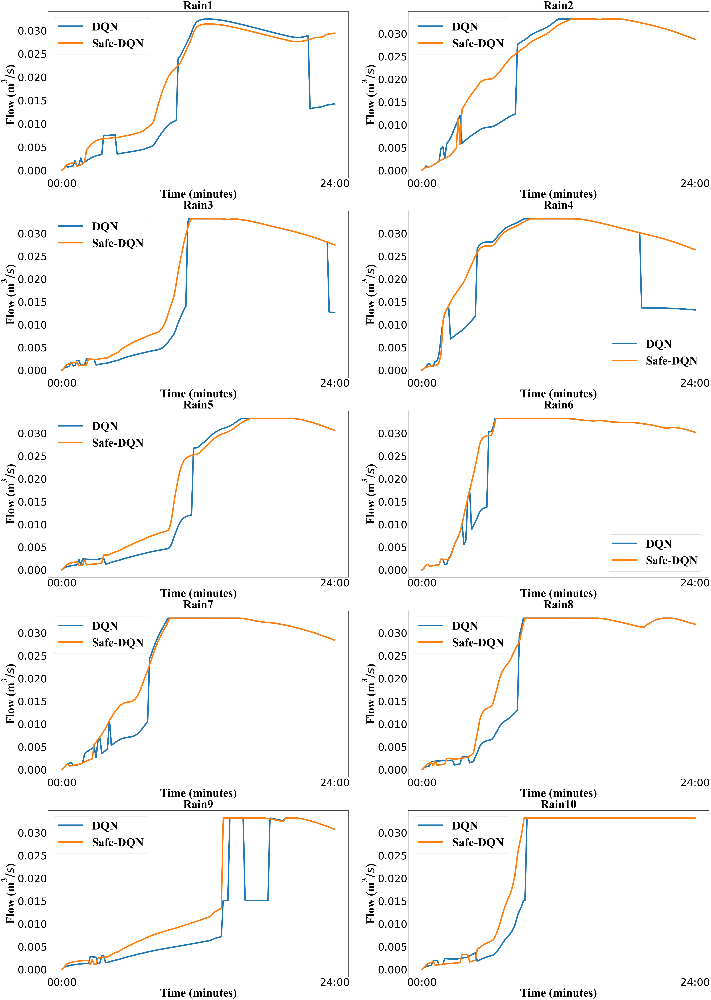

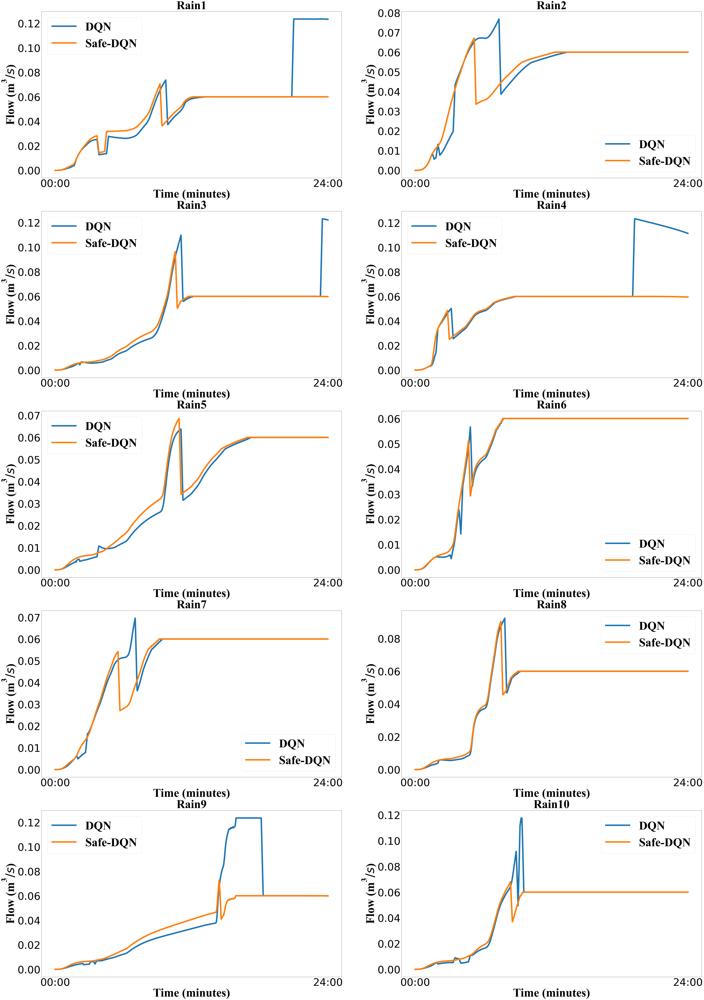

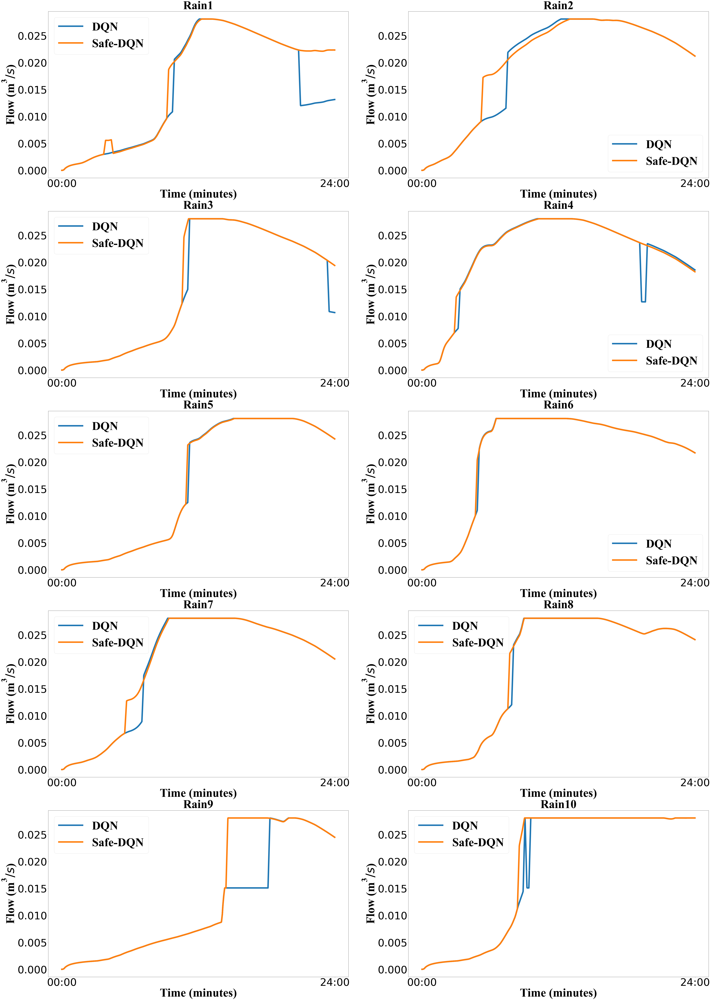

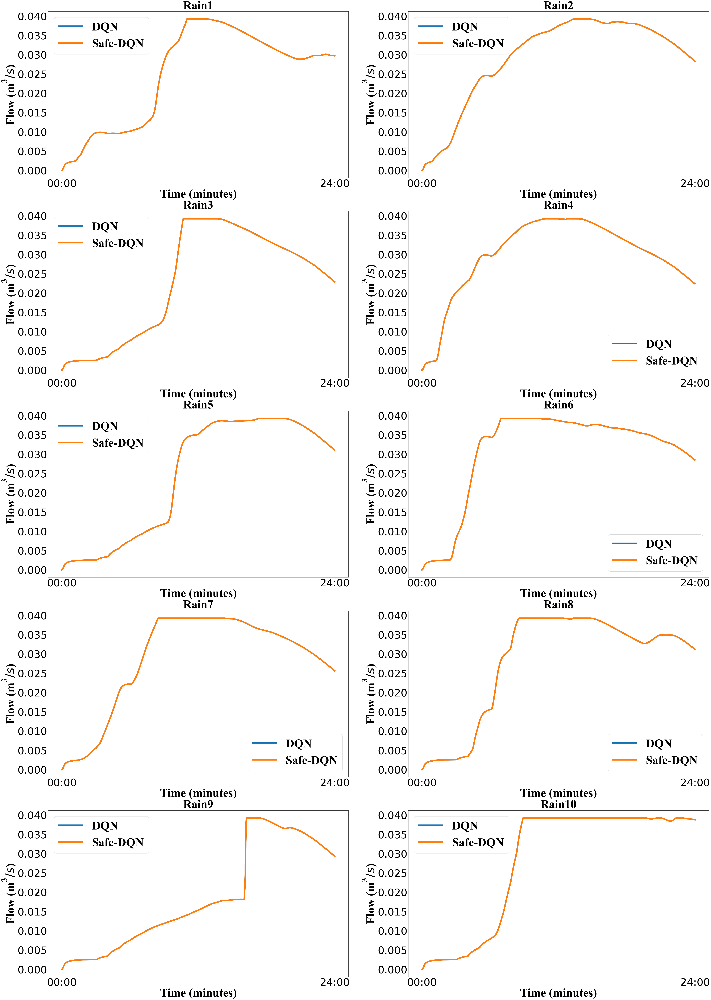

...

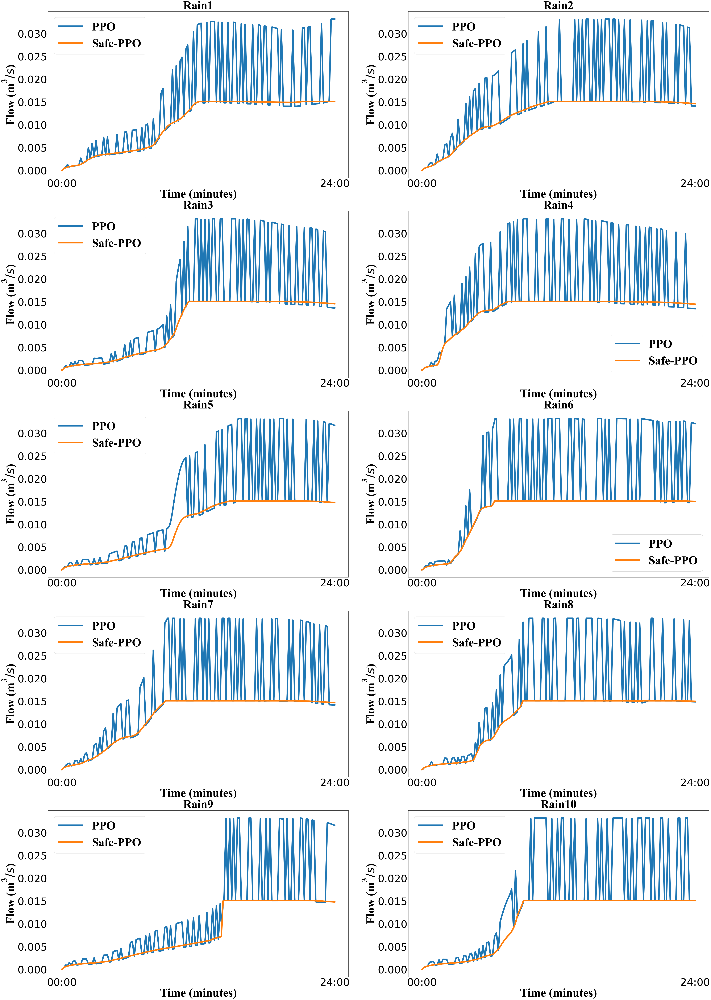

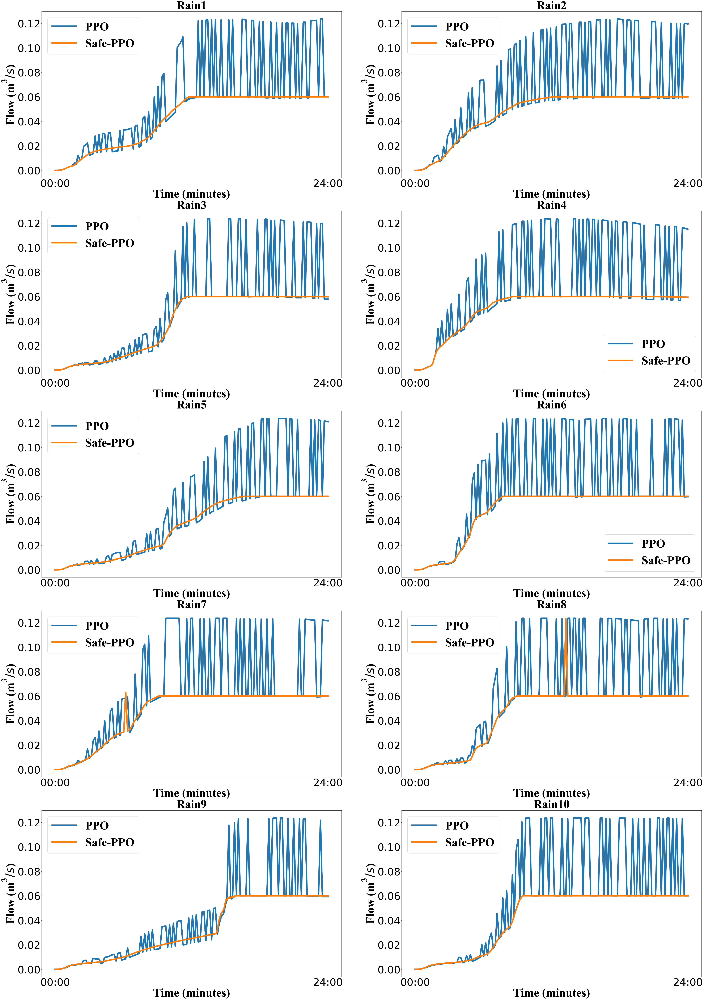

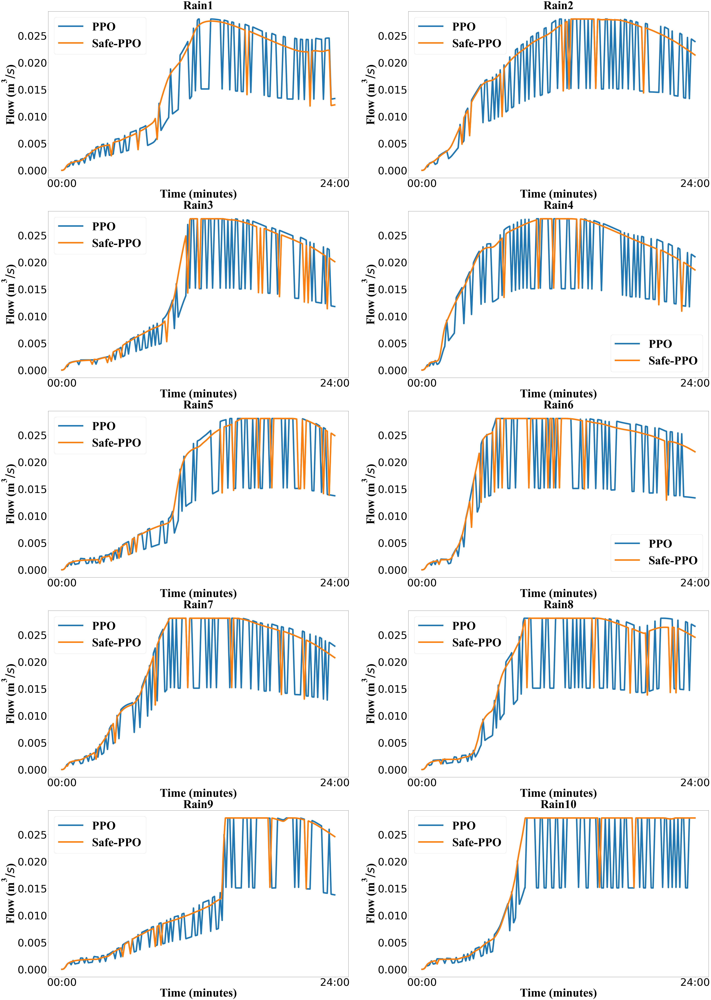

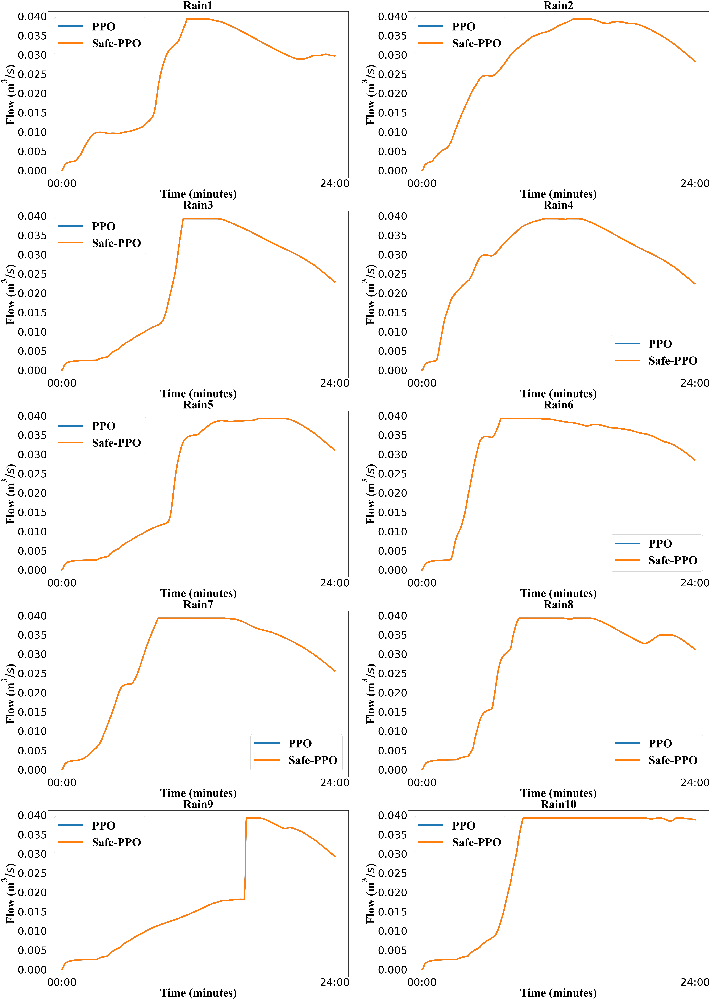

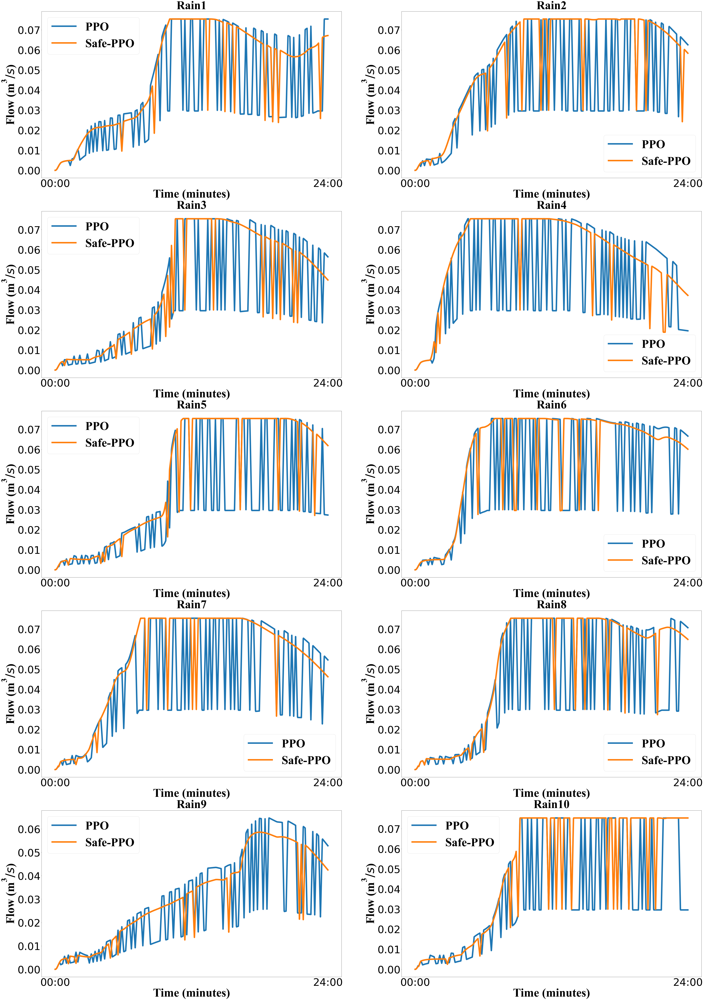

In [15]:
#从out文件直接读取数据画图
for lab in ['DQN','PPO']:
    for i in ['V1','V2','V3','V4','V5','V6']:
        pool_list=[i]
        V=pool_list[0]
        if lab=='DQN':
            titles=['DQN','Safe-DQN']
        else:
            titles=['PPO','Safe-PPO']
        #每场降雨含有两列数据，0代表DQN，1代表Safe-DQN
        
        #40和80分别读取
        data={}
        rainid=0
        #40，选3,5,6,7,9
        packs=['final-noAFI-drain-40','final-noAFI-drain-80']
        for pack in packs:
            if pack=='final-noAFI-drain-40':
                rs=[3,5,6,7,9]
            else:
                rs=[1,4,5,7,9]
            for rain in rs:
                if lab=='DQN':
                    filename='./'+pack+'/ddqn nosafe_test_result/'+str(rain)+'.out'
                else:
                    filename='./'+pack+'/ppo2 nosafe_test_result/'+str(rain)+'.out'
                tem1=get_output.flow_all(filename,pool_list)[pool_list[0]]
                if lab=='DQN':
                    filename='./'+pack+'/ddqn safe_test_result/'+str(rain)+'.out'
                else:
                    filename='./'+pack+'/ppo2 safe_test_result/'+str(rain)+'.out'
                tem2=get_output.flow_all(filename,pool_list)[pool_list[0]]
                data[str(rainid)]=[tem1,tem2]
                rainid+=1

        print(len(data['0'][0]))

        #画图
        fig=plt.figure(figsize=(80,120))
        font1 = {'family' : 'Times New Roman',
        'weight' : 'normal',
        'size' : 80,
        }
        font0 = {'family' : 'Times New Roman',
        'weight' : 'normal',
        'size' : 80,
        }


        myt=['00:00','24:00']
        myx=[0,len(data['0'][0])]
        img=1
        for i in range(1,6):
            for j in range(1,3):
                fig.add_subplot(5,2,img)
                k=0
                for i in range(3,5):
                    plt.title('Rain'+str(img),fontdict=font0)
                    plt.plot(data[str(img-1)][k],linewidth=10,label=titles[k])
                    plt.xticks(myx,myt,fontsize=70)
                    plt.yticks(fontsize=70)
                    plt.xlabel('Time (minutes)',font1)
                    plt.ylabel('Flow ($\mathregular{m^3}/s$)',font1)
                    k=k+1
                img+=1
                plt.legend(prop=font1)
        
        fig.savefig('5.1.2-'+V+'_'+lab+'_.png',bbox_inches='tight',dpi=200)

# 读取V1-V6控制曲线，统计控制频率

In [4]:
#从inp文件中读取
from swmm_api.input_file.section_labels import TIMESERIES
from swmm_api import read_inp_file

In [5]:
items=['BC_test_result','EFD_test_result',
       'ddqn nosafe_test_result','ddqn safe_test_result',
       'ppo2 nosafe_test_result','ppo2 safe_test_result']
data={}


packs=['final-noAFI-drain-40','final-noAFI-drain-80']

for item in items:
    rainid=0
    for pack in packs:
        if pack=='final-noAFI-drain-40':
            rs=[3,5,6,7,9]
        else:
            rs=[1,4,5,7,9]
        ttem=[]
        for rain in rs:
            tem=[]
            file='./'+pack+'/'+item+'/'+str(rain)
            inp = read_inp_file(file+'.inp', convert_sections=[TIMESERIES])  # type: swmm_api.SwmmInput
            sec_timeseries = inp[TIMESERIES]
            for pump in ['pump_0','pump_1','pump_2','pump_3','pump_4','pump_5']:
                ts = inp[TIMESERIES][pump].frame
                tem.append(ts.values.tolist())
            #ttem.append(tem)#一场降雨一个矩阵
            data[item+'_Rain'+str(rainid+1)]=tem 
            rainid+=1

In [6]:
#统计变化次数的函数
def count(line):
    c=0
    for i in range(1,line.shape[0]):
        if line[i]!=line[i-1]:
            c+=1
    return c

In [10]:
items=['ddqn nosafe_test_result','ddqn safe_test_result',
       'ppo2 nosafe_test_result','ppo2 safe_test_result']
save=[]
for rain in range(10):
    c=[]
    for item in items:
        a=np.array(data[item+'_Rain'+str(rain+1)])
        temc=[]
        for i in range(a.shape[0]):
            temc.append(count(a[i,:]))
        c.append(sum(temc))
    print('Rain'+str(rain+1)+':',c,' ',sum(c))
    save.append(c)

#保存excel
pd.DataFrame(save).to_excel('operation.xlsx')

Rain1: [21, 8, 282, 29]   340
Rain2: [19, 6, 300, 34]   359
Rain3: [19, 4, 287, 55]   365
Rain4: [18, 3, 289, 28]   338
Rain5: [20, 6, 273, 48]   347
Rain6: [18, 4, 273, 36]   331
Rain7: [18, 4, 279, 34]   335
Rain8: [14, 6, 280, 36]   336
Rain9: [14, 6, 284, 30]   334
Rain10: [20, 6, 281, 35]   342


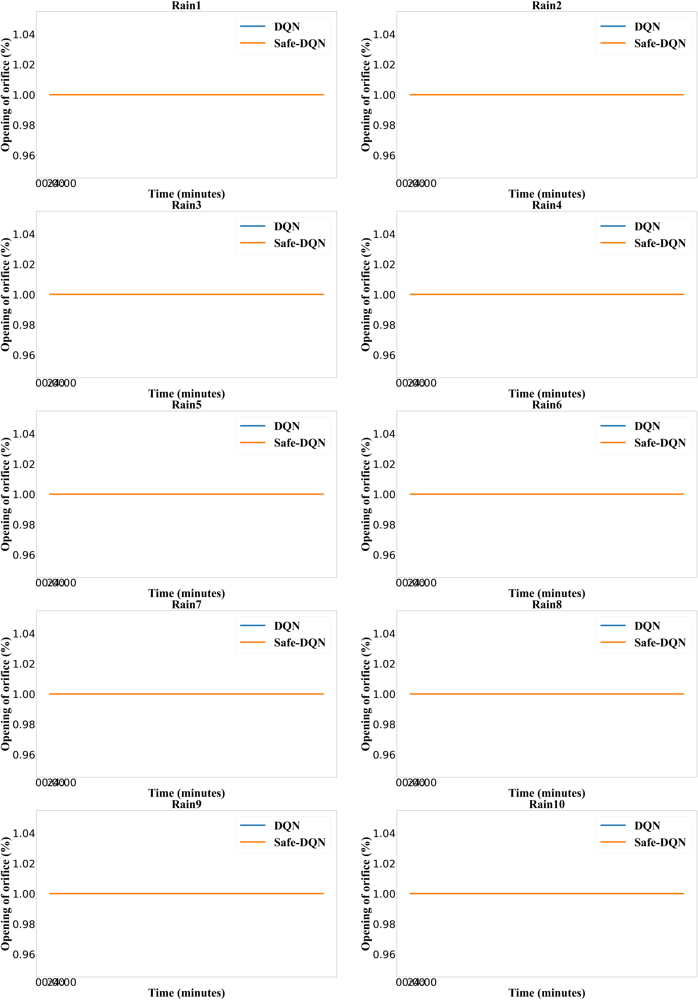

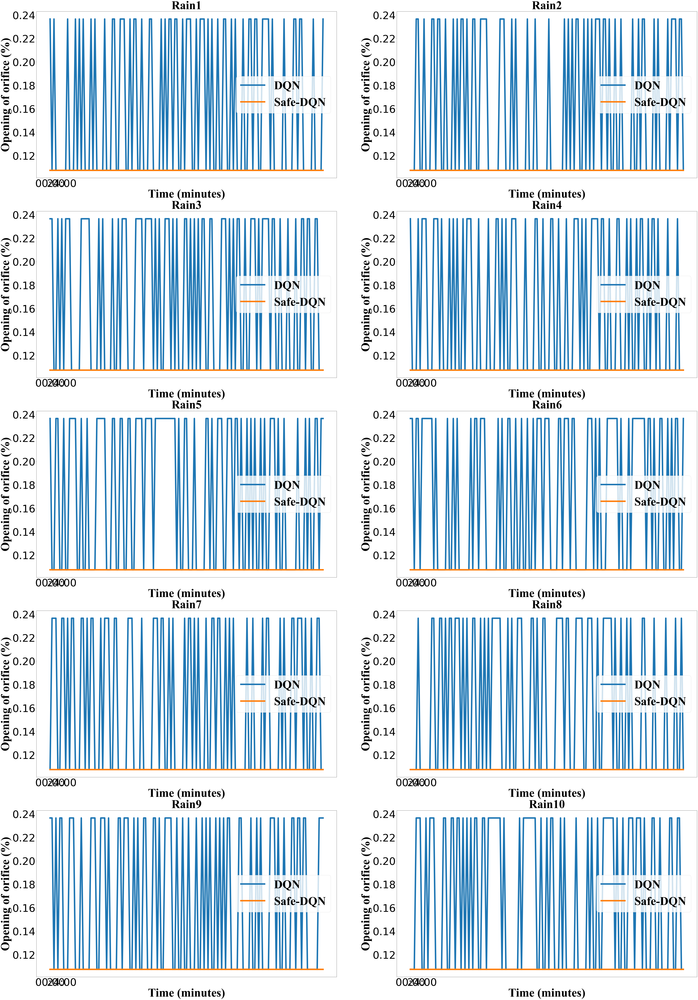

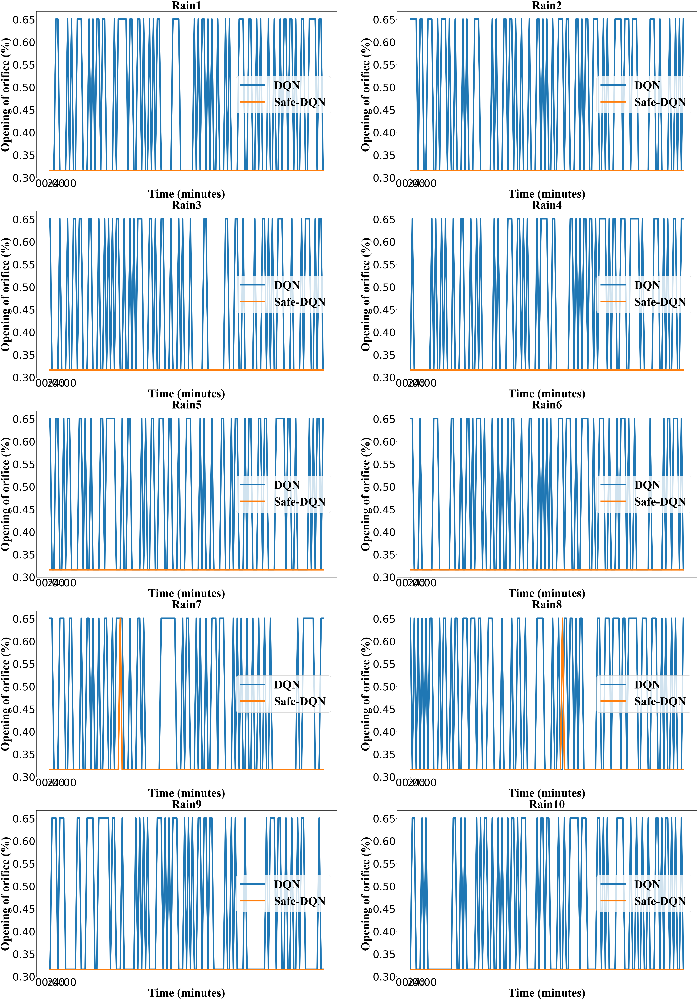

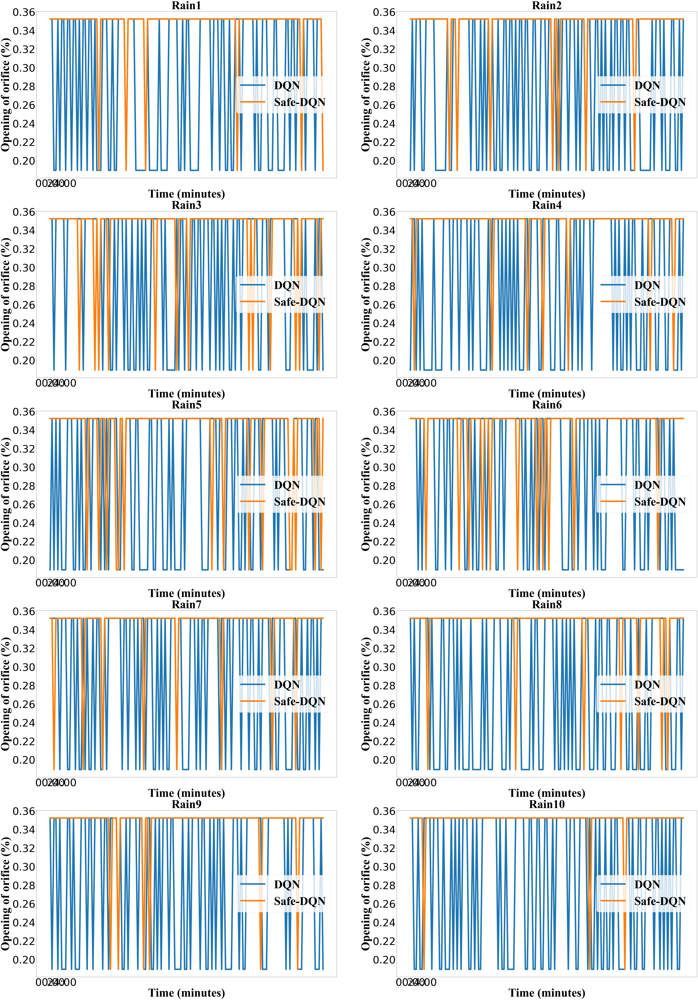

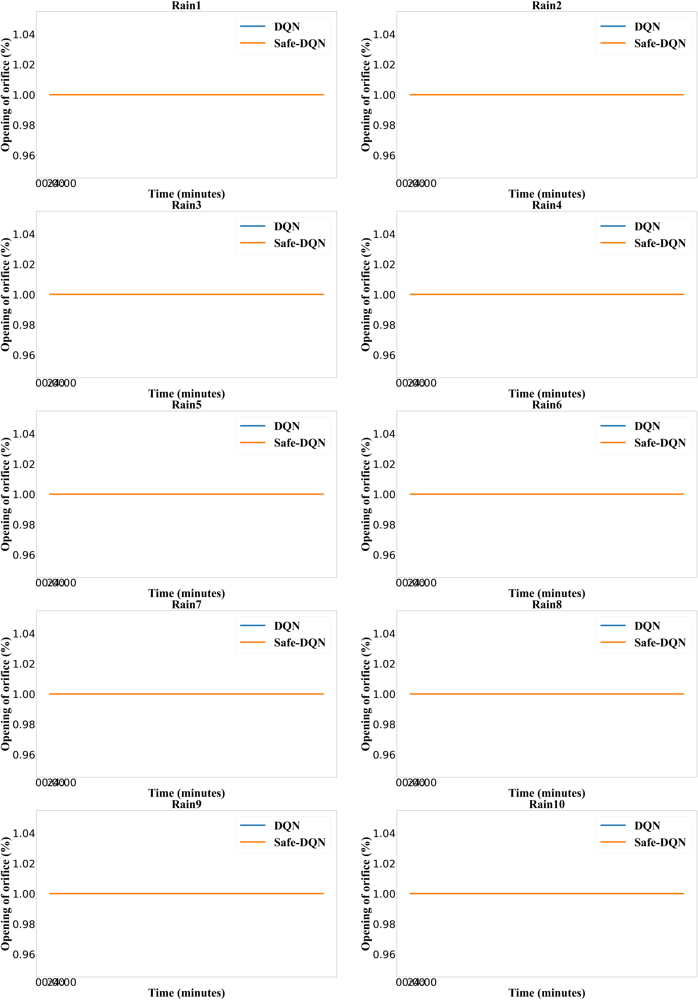

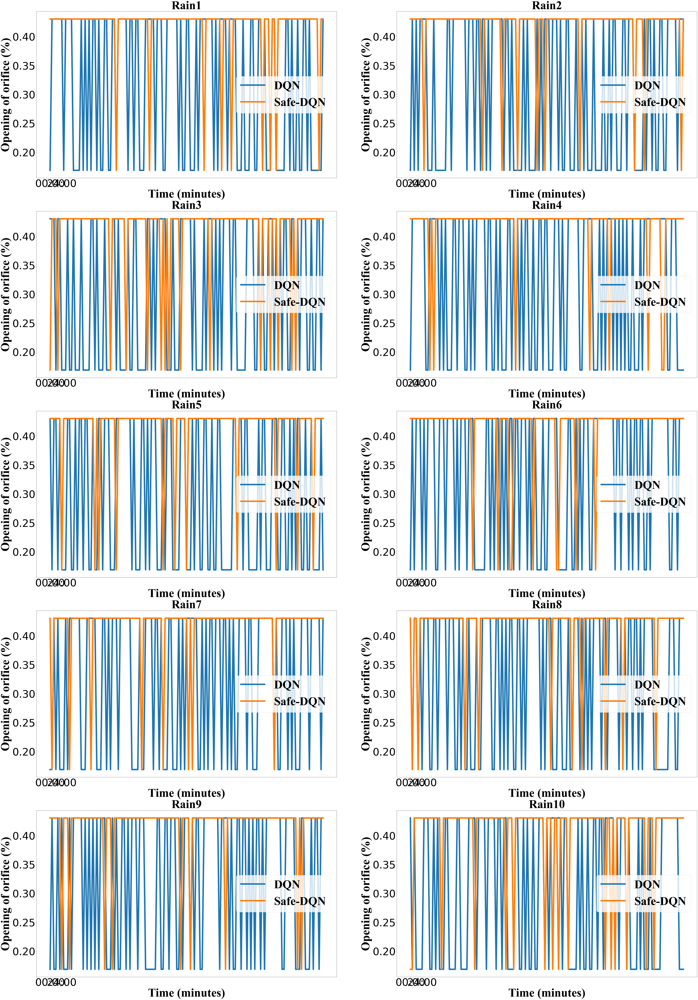

In [20]:
#做控制过程图
RL='PPO'
if RL=='DQN':
    items=['ddqn nosafe_test_result','ddqn safe_test_result']
else:
    items=['ppo2 nosafe_test_result','ppo2 safe_test_result']
titles=['DQN','Safe-DQN']
'''
for rain in range(10):
    plt.figure()
    for item in items:
        a=np.array(data[item+'_Rain'+str(rain+1)])
        plt.plot(a[V,:],label=item)
    plt.legend()

'''
#画图

font1 = {'family' : 'Times New Roman',
        'weight' : 'normal',
        'size' : 80,
        }
font0 = {'family' : 'Times New Roman',
        'weight' : 'normal',
        'size' : 80,
        }

for V in range(6):
    myt=['00:00','24:00']
    myx=[0,len(data[items[0]+'_Rain1'][0:])]
    img=1
    fig=plt.figure(figsize=(80,120))
    for i in range(1,6):
        for j in range(1,3):
            fig.add_subplot(5,2,img)
            k=0
            for i in range(3,5):
                plt.title('Rain'+str(img),fontdict=font0)
                a=np.array(data[items[k]+'_Rain'+str(img)])
                plt.plot(a[V,:],linewidth=10,label=titles[k])
                plt.xticks(myx,myt,fontsize=70)
                plt.yticks(fontsize=70)
                plt.xlabel('Time (minutes)',font1)
                plt.ylabel('Opening of orifice (%)',font1)
                k=k+1
            img+=1
            plt.legend(prop=font1)
    fig.savefig('5.1.2-open-V_'+str(V)+'_'+RL+'_.png',bbox_inches='tight',dpi=200)

# 统计action上下限，用于证明HIRL有效

In [7]:
#从inp文件中读取
from swmm_api.input_file.section_labels import TIMESERIES
from swmm_api import read_inp_file

In [23]:
items=['ddqn nosafe_test_result','ppo2 nosafe_test_result']
packs=['final-noAFI-drain-40','final-noAFI-drain-80']

sd=[]
for item in items:
    data=[]
    rainid=0
    for pack in packs:
        if pack=='final-noAFI-drain-40':
            rs=[3,5,6,7,9]
        else:
            rs=[1,4,5,7,9]
        for rain in rs:
            tem_max,tem_min=[],[]
            file='./'+pack+'/'+item+'/'+str(rain)
            inp = read_inp_file(file+'.inp', convert_sections=[TIMESERIES])  # type: swmm_api.SwmmInput
            sec_timeseries = inp[TIMESERIES]
            for pump in ['pump_0','pump_1','pump_2','pump_3','pump_4','pump_5']:
                ts = inp[TIMESERIES][pump].frame
                tem_max.append(np.max(ts))
                tem_min.append(np.min(ts))
                #print(tem_max,tem_min)
            #ttem.append(tem)#一场降雨一个矩阵
            data.append(tem_max)
            data.append(tem_min)
            rainid+=1
    #data=np.array(data)
    max_d=np.max(data,axis=0).tolist()
    min_d=np.min(data,axis=0).tolist()
    print(max_d)
    sd.append(max_d)
    sd.append(min_d)
    
pd.DataFrame(sd).to_excel('nosafe upper_lower_Action.xlsx')

[1.0, 0.2366, 0.6508, 0.3523, 1.0, 0.4303]
[1.0, 0.23659999668598175, 0.6507999897003174, 0.3522999882698059, 1.0, 0.4302999973297119]
